<a href="https://colab.research.google.com/github/Ivan-Smrnv/Portfolio/blob/master/Clusterization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Машинное обучение. ВМК МГУ.
## Практическое задание 7: Кластеризация. Методы снижения размерности.



In [ ]:
%config Completer.use_jedi = False
%load_ext autoreload
%autoreload 2

# 0. Введение. [кросспроверка 2 балла]

## 0.1 О задании

В данной работе вам предстоит познакомится с методами машинного обучения без учителя — кластеризацией и алгоритмами снижения размерности.

В данном задании предлагается две основных части ($1, 2$) и одна вспомогательная ($0$). Сумарное всемя выполнения ноутбука порядка тридцати минут при выполнении в `Google Colab`.

## 0.2 Необходимые библиотеки

### Установка в Google Colab
Если вы используете Google Colab, то вам достаточно установить библиотеки с помощью ячейки ниже.

После установки нужных версий нажмите на кнопку `Restart runtime`, которая появится в следующей ячейке после завершения ее выполнения.

После перезапуска (`Restart runtime`) устанавливать библиотеки еще раз не нужно, достаточно проверить, что установилась их новая версия.

**Важно!**
Устанавливать нужные версии нужно каждый раз, когда создается новый рантайм. Например, если вы 2 часа подряд делаете это задание, то подготовить библиотеки достаточно 1 раз. Но если вы, например, начали в понедельник, затем закрыли/выключили ноутбук, то при продолжении в среду, вам нужно будет запустить рантайм заново и следовательно заново установить библиотеки.

**Обратите внимание, что установка `torch` и `tensorflow` через `pip` может сломать ваше окружение, особенно если вы используете GPU. Выполняйте их установку в соответствии с Вашей конфигурацией системы или в отдельном виртуальном окружении**

<font color="red">Внимание! Окружение с библиотеками обновилось! </font> Для уменьшения числа ошибок из-за разных версий советуем локально сделать новое вирутальное окружение с новым requirements2.txt https://drive.google.com/file/d/1emagLwrQrZoaitHvoRkp2ZOFNg0TsZdR/view?usp=share_link . Старое окружение лучше оставить для совместимости с предыдущими заданиями (если захотите их еще дорешать)

Окружения с библиотеками можно создать  следующим образом

**using pip**

    python3 -m venv <env_name>
    source <env_name>/bin/activate
    pip3 install -r requirements2.txt

**using Conda**

    conda create --name <env_name> --file requirements2.txt


In [ ]:
! gdown 17FhOhXBB9vlXP5Xoy1Ge_ugVGaw_5VLa
! pip install -r ./requirements2.txt

if 'google.colab' in str(get_ipython()):
    import IPython, ipywidgets, google

    button = ipywidgets.Button(
        description='Нажмите, чтобы перезапустить Google Colab Runtime',
        layout=ipywidgets.Layout(width='auto', height='40px')
    )
    button.on_click(lambda _: get_ipython().kernel.do_shutdown(True))
    IPython.display.display(button)

Downloading...
From: https://drive.google.com/uc?id=17FhOhXBB9vlXP5Xoy1Ge_ugVGaw_5VLa
To: /content/requirements2.txt
100% 416/416 [00:00<00:00, 550kB/s]
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.6/76.6 MB 8.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 36.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 511.6/511.6 KB 28.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.4/134.4 KB 6.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 23.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.2/11.2 MB 40.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 28.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.2/12.2 MB 49.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.5/41.5 KB 3.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━

Button(description='Нажмите, чтобы перезапустить Google Colab Runtime', layout=Layout(height='40px', width='au…

Здесь перечислены основные функции и библиотеки, которые могут понадобиться Вам в процессе выполнения задания. Подключение других библиотек возможно, но нежелательно. **Работа каких-либо других библиотек не гарантируется.**

In [ ]:
import os

import gdown

import scipy

import numpy as np

import tqdm.auto as tqdm

import matplotlib
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

from ipywidgets import interactive, fixed, interact_manual, IntSlider, FloatLogSlider, FloatSlider

import torch
from torchvision.datasets import CIFAR10

# Необходима преварительная установка tensorflow
from keras.applications.inception_v3 import InceptionV3, preprocess_input

import sklearn

from sklearn.decomposition import KernelPCA
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering

# Библиотека umap-learn, а не umap
from umap import UMAP
from sklearn.manifold import TSNE, Isomap

from sklearn.model_selection import train_test_split
from sklearn.datasets import make_classification, make_moons, make_blobs
from sklearn.preprocessing import StandardScaler, MinMaxScaler

from warnings import simplefilter
from sklearn.exceptions import ConvergenceWarning
simplefilter("ignore", category=ConvergenceWarning)

## 0.3 Введение в интерактивные графики jupyter notebook [кросспроверка 2 балла]

Информация об особенностях интерактивных графиков вынесена в отдельный ноутбук [Deep_dive_into_ipynb[Tutorial].ipynb](https://colab.research.google.com/drive/1KKe2z1AqWtgtTjbsoJjqiaUesRF_gsU2?usp=sharing). **Ознакомьтесь с ним перед дальнейшим выполнением задания!**

#### **Задание 0.0 [кросспроверка, 2 балла][код, вопрос]**
* Сделайте $2\text{-}3$ различных интерактивных графика.
* Посмотрите в чём заключается смысл функций [`interactive`, `interact_manual`, `fixed`, `IntSlider`, `FloatLogSlider`](https://ipywidgets.readthedocs.io/en/latest/examples/Using%20Interact.html).
* Какие ещё [слайдеры и динамические виджеты бывают](https://ipywidgets.readthedocs.io/en/latest/examples/Widget%20List.html)?
* Как вам кажется, удобный ли это инструмент?
* Предложите несколько примеров, когда он мог бы ещё пригодиться.

In [ ]:
%matplotlib ipympl

try:
    from google.colab import output
    output.enable_custom_widget_manager()
except:
    pass

In [ ]:
# Нарисуем гистограмму нормального распределения с различными параметрами
# на мат ожидание, стандартное отклонение и размер выборки

def normal_distribution_1(mu, sigma, num):
    if not hasattr(normal_distribution_1, 'prev_fig'):
        (
            normal_distribution_1.prev_fig,
            normal_distribution_1.prev_ax
        ) = plt.subplots(1, 1, figsize=(8, 4))

    if normal_distribution_1.prev_fig is not None:
        normal_distribution_1.prev_ax.clear()

    fig, ax = normal_distribution_1.prev_fig, normal_distribution_1.prev_ax
    x = np.random.normal(mu, sigma, num)
    ax.hist(x, bins = 70, density=True, edgecolor = 'black')
    ax.set_title('Гистограмма нормально распределённой выборки')
    ax.grid(True)

# interactive, FloatSlider, IntSlider
interactive_plot_1 = interactive(
    normal_distribution_1,
    mu=IntSlider(value=0, min=-6, max=6, step=1, description=r'$\mu$'),
    sigma=FloatSlider(value=1, min=1.0, max=6.0, step=0.5, description=r'$\sigma$'),
    num=IntSlider(value=500, min=50, max=1000, step=50, description=r'number')
)
interactive_plot_1

interactive(children=(IntSlider(value=0, description='$\\mu$', max=6, min=-6), FloatSlider(value=1.0, descript…

interactive(children=(IntSlider(value=0, description='$\\mu$', max=6, min=-6), FloatLogSlider(value=1.25892541…

<function __main__.normal_distribution_2(mu, sigma, num)>

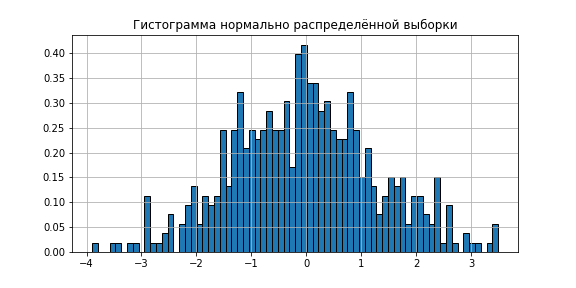

In [ ]:
def normal_distribution_2(mu, sigma, num):
    if not hasattr(normal_distribution_2, 'prev_fig'):
        (
            normal_distribution_2.prev_fig,
            normal_distribution_2.prev_ax
        ) = plt.subplots(1, 1, figsize=(8, 4))

    if normal_distribution_2.prev_fig is not None:
        normal_distribution_2.prev_ax.clear()

    fig, ax = normal_distribution_2.prev_fig, normal_distribution_2.prev_ax
    x = np.random.normal(mu, sigma, num)
    ax.hist(x, bins = 70, density=True, edgecolor = 'black')
    ax.set_title('Гистограмма нормально распределённой выборки')
    ax.grid(True)


# interact_manual, fixed, FloatLogSlider, IntSlider
interactive_plot_2 = interact_manual(
    normal_distribution_2,
    mu=IntSlider(value=0, min=-6, max=6, step=1, description=r'$\mu$'),
    sigma=FloatLogSlider(value=1e-1, min=1e-1, max=1.0, step=0.01, base=10, description=r'$\sigma$'),
    num=fixed(500)
)

interactive_plot_2

interactive(children=(IntSlider(value=6, description='degrees of freedom', max=15, min=1), Output()), _dom_cla…

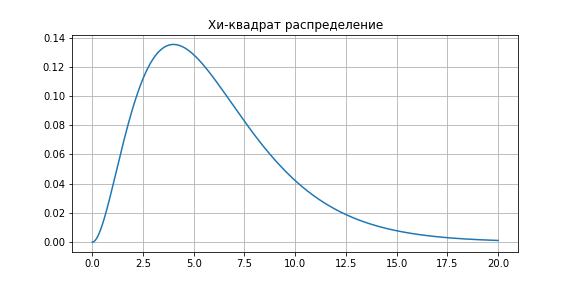

In [ ]:
from scipy. stats import chi2

def Chi_square_distribution(df):
    if not hasattr(Chi_square_distribution, 'prev_fig'):
        (
            Chi_square_distribution.prev_fig,
            Chi_square_distribution.prev_ax
        ) = plt.subplots(1, 1, figsize=(8, 4))

    if Chi_square_distribution.prev_fig is not None:
        Chi_square_distribution.prev_ax.clear()

    fig, ax = Chi_square_distribution.prev_fig, Chi_square_distribution.prev_ax
    x = np.arange (0, 20, 0.001)
    #plot Chi-square distribution
    ax.plot(x, chi2. pdf (x, df = df ))
    ax.set_title('Хи-квадрат распределение')
    ax.grid(True)

# interactive
interactive_plot_3 = interactive(
    Chi_square_distribution,
    df = IntSlider(value=6, min=1, max=15, step=1, description=r'degrees of freedom'),
)
interactive_plot_3

*Ответ:* Я построил три графика с использованием разных виджетов. Из них видно, что:  
1. interactive устанавливает параметр сразу после выбора нового значения.
2. interact_manual позволяет сначала выбрать все необходимые значения и уже после этого применять их к графику.
3. fixed позволяет зафиксировать одно из значений и менять остальные.
4. IntSlider рисует ползунок, который можно двигать и выбирать новые значения в определённом диапозоне, с нужным шагом.
5. FloatLogSlider позволяет делать то же самое, что и IntSlider, только покрывает больший диапозон при тех же граничных условиях, так как возводит заданное основание (base) в степень.  
Также бывают просто FloatSlider, FloatRangeSlider. Если говорить про виджеты, то Checkbox, Valid, Dropdown и другие.  
Я считаю, что интерактивные графики очень удобны, так как позволяют быстро вызуализировать данные при разные входных параметрах. Их можно применять в различных экспериментах, где необходимо исследовать аномалии в данных, странные поведения сложных функций.

<font color='red'>**Обратите внимание, что динамическое содержимое может некорректно сохраняться в jupyter notebook. Используйте его только для локальной визуализации. Все графики, необходимые для сдачи задания должны быть статическими. Переход в статический режим происходит с помощью магической команды `%matplotlib inline` (приведена ниже).**</font>

**Обязательно убедитесь, что все графики корректно сохранились корректно в ноутбуке перед сдачей в систему.**

In [ ]:
%matplotlib inline
matplotlib.rcParams['figure.dpi'] = 300

## 0.4 Ещё несколько важных замечаний

При выполнении задания <font color='red'>запрещено</font>:
1. Менять те seed, которые явно указаны в коде
2. Менять прототипы функций, классов, методов классов
3. Менять константы, используемые для генерации выборок

При оформлении задания обратите внимание на форматирование кода и на оформление графиков:

* Весь код должен быть оформлен в строгом соответствии с [PEP8](https://pep8.org/)

Графики должны быть с одной стороны понятными и информативными, а с другой стороны *красивыми*. Вот несколько пунктов, которые помогут удовлетворить этим требования:
1. Все графики должны быть отрисованы в **векторном формате**. Обратите внимание, что смена режима графиков с динамического на статический и обратно может приводить к сбросу параметров отрисовки графиков. Переход в векторный режим можно выполнить с помощью команды `matplotlib_inline.backend_inline.set_matplotlib_formats('pdf', 'svg')`. Если изображения в векторном формате приводят к слишком большому размеру Jupyter Notebook можете использовать растровые изображения с **высоким dpi**. Напирмер, можно установить глобальный dpi в matplotlib: `matplotlib.rcParams['figure.dpi'] = 300`
2. На всех графиках без исключения должна быть нарисована сетка
3. Все графики и группы графиков должны иметь заголовок (`title`)
4. При необходимости оси должны быть подписаны
5. Если на графике отображено несколько сущностей (линии/точки/bar разных цветов, формы и так далее), то необходима исчерпывающая легенда
6. Все линии на графиках должны быть чётко видны (нет похожих цветов или цветов, сливающихся с фоном и так далее)
7. Масштаб по каждой оси на графике должен быть выбран правильно. Используйте масштабы `log`, `symlog` по необходимости
8. Если отображена величина, имеющая очевидный диапазон значений (например, проценты могут быть от 0 до 100), то желательно масштабировать ось на весь диапазон значений (исключением является случай, когда вам необходимо показать малое отличие, которое незаметно в таких масштабах)
9. Частота отметок по каждой оси должна быть тщательно подобрана, по необходимости задавайте `[xy]ticks`, `[xy]ticklabels` вручную. Подписи тиков на осях не должны сливаться как на одной оси, так и между ними
10. Помните, что matplotlib умеет выполнять [рендеринг Latex](https://matplotlib.org/stable/gallery/text_labels_and_annotations/tex_demo.html). Используйте эту возможность для написания формул в заголовках, легенде и в подписях осей
11. Используйте *красивую* цветовую палитру с хорошо различимыми цветами. Примеры цветовых палитр можно посмотреть [здесь](https://matplotlib.org/stable/gallery/color/colormap_reference.html). При наличи особенностей восприятия цвета можно использовать специальные палитры:
```python
plt.style.use('seaborn-colorblind')
# Или
plt.style.use('tableau-colorblind10')
# Затем, при отрисовке графиков не используйте параметр cmap
```
12. Графики должны быть не супер-микро и не супер-макро по размерам, так, чтобы можно было увидеть все, что нужно

# 1. Кластеризация на синтетических данных. [кросспроверка 9 баллов,  unittests 16 баллов]

В данной части мы рассмотрим несколько наборов синтетических данных и сравним как разные алгоритмы кластеризации ведут себя в низкоразмерных и высокоразмерных пространствах

## a. Двумерные данные

Сгенерируем двумерные данные с $4$ естественными кластерами разного размера и плотности.

In [ ]:
data_moons, labels_moons = make_moons(n_samples=300, shuffle=True, noise=0.09, random_state=6417)
data_moons, labels_moons = data_moons[labels_moons == 0], labels_moons[labels_moons == 0]

data_blobs, labels_blobs = make_blobs(
    n_samples=500, n_features=2, centers=[(0, -0.2), (-1.5, -1.5), (-1.5, 1.5)],
    cluster_std=[0.2, 0.4, 0.6], center_box=[-10.0, 10.0],
    shuffle=True, random_state=6417, return_centers=False
)

data = np.concatenate([data_moons, data_blobs])
labels = np.concatenate([labels_moons, labels_blobs + 1])

In [ ]:
def plot_2d_data(data, labels, title='Исходные данные', cmap='tab20', ax=None):
    '''
    Отрисовка 2d scatter plot.
    :param np.ndarray data: 2d массив точек
    :param Union[list, np.ndarray] labels: список меток для каждой точки выборки
    :param str title: Заголовок графика
    :param str cmap: Цветовая палитра
    :param ax Optional[matplotlib.axes.Axes]: Оси для отрисовки графика.
        Если оси не заданы, то создаётся новая фигура и сразу же происходит её отрисовка
        Иначе, график добавляется на существуюущие оси. Отрисовки фигуры не происходит
    '''
    n_clusters = len(np.unique(labels))

    if ax is None:
        fig, ax = plt.subplots(1, 1, figsize=(10, 5))
    else:
        fig = None

    scatter = ax.scatter(
        data[:, 0], data[:, 1], c=labels,
        cmap=plt.get_cmap(cmap, n_clusters)
    )

    cbar = plt.colorbar(scatter, label='Номер кластера', ax=ax)
    cbar.set_ticks(np.min(labels) + (np.arange(n_clusters) + 0.5) * (n_clusters - 1) / n_clusters)
    cbar.set_ticklabels(np.unique(labels))

    ax.set_title(title)
    ax.grid(True)

    if fig is not None:
        fig.tight_layout()
        plt.show()

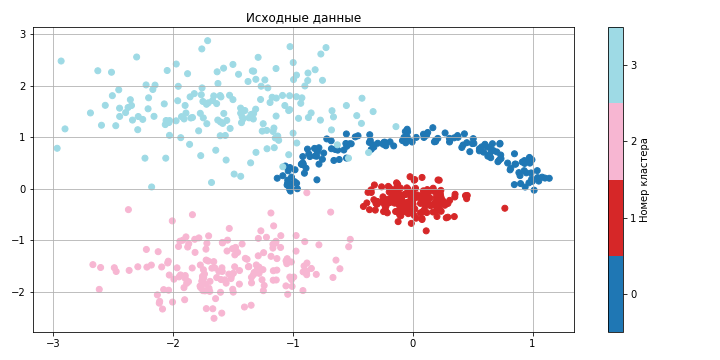

In [ ]:
plot_2d_data(data, labels, title='Исходные данные', cmap='tab20')

#### **Задание 1.a.1 [кросспроверка, 1 балл][код]**
<a id='task_1.a.1'></a>
Запустите следующие алгоритмы кластеризации на данной выборке: `KMeans`, `DBSCAN`, `AgglomerativeClustering`. Визуально подберите наилучшие параметры для этих алгоритмов (`n_clusters`, `eps`, `min_samples`, `linkage`). Изобразите наилучшие получившиеся разбиения на графиках.

*Советы:*
1. Используйте виджеты для ручного подбора параметров
2. Используйте готовую функцию `plot_2d_data` для отрисовки графиков. Обязательно меняйте заголовок

In [ ]:
def alg_KMeans(data, n):
    kmeans = KMeans(n_clusters=n).fit(data)
    plot_2d_data(data, kmeans.labels_, title='Алгоритм KMeans', cmap='tab20')

interactive_plot_KMeans = interactive(
    alg_KMeans,
    data=fixed(data),
    n=IntSlider(value=4, min=1, max=10, step=1, description=r'n')
)
interactive_plot_KMeans

interactive(children=(IntSlider(value=4, description='n', max=10, min=1), Output()), _dom_classes=('widget-int…

In [ ]:
def alg_DBSCAN(data, eps, samples):
    dbscan = DBSCAN(eps=eps, min_samples=samples).fit(data)
    plot_2d_data(data, dbscan.labels_, title='Алгоритм DBSCAN', cmap='tab20')

interactive_plot_DBSCAN = interactive(
    alg_DBSCAN,
    data=fixed(data),
    eps=FloatLogSlider(value=0.5, min=-10, max=10, step=0.01, description=r'eps'),
    samples=IntSlider(value=5, min=1, max=50, step=1, description=r'min_samples')
)
interactive_plot_DBSCAN

interactive(children=(FloatLogSlider(value=0.5, description='eps', max=10.0, min=-10.0, step=0.01), IntSlider(…

In [ ]:
from ipywidgets import Dropdown

def alg_AgglomerativeClustering(data, clusters, linkage):
    aggclust = AgglomerativeClustering(n_clusters = clusters, linkage=linkage).fit(data)
    plot_2d_data(data, aggclust.labels_, title='Алгоритм AgglomerativeClustering', cmap='tab20')

interactive_plot_AgglomerativeClustering = interactive(
    alg_AgglomerativeClustering,
    data=fixed(data),
    clusters=IntSlider(value=4, min=1, max=10, step=1, description=r'n_clusters'),
    linkage=Dropdown(
        options=['ward', 'complete', 'average', 'single'],
        value='ward',
        description='linkage:',
        disabled=False)
)
interactive_plot_AgglomerativeClustering

interactive(children=(IntSlider(value=4, description='clusters', max=10, min=1), Dropdown(description='linkage…

#### **Задание 1.a.2 [кросспроверка, 1 балл][вопрос]**
Основываясь на знании о работе данных алгоритмов, объясните, почему кластеры были сформированы таким образом. Какой алгоритм лучше всего работает на предложенных данных?

*Ответ:* В случае KMeans получилось такое разбинение, так как алгоритм рассматривал ближайших соседей, поэтому дугу полностью выделить в отдельный клстер не вышло.  
Алгоритм DBSCAN разбивает данные на кластеры, основываясь на плотности группировки данных, поэтому он справился с кластеризацией лучше всех.  
AgglomerativeClustering удовлетворительно справляется с задачей только при метрике 'ward', но разбиение на клстеры близко к KMeans, несмотря на иерархическую кластеризацию.  
На предложенных данных **лучше всего работает алгоритм DBSCAN**.

## b. Многомерные данные. Снижение размерности

Теперь попробуем кластеризовать данные в высокоразмерном пространстве. Существенным отличием от двумерного случая является невозможность прямой визуальной оценки кластеризации.

Одним из наглядных способов оценки кластеризации является снижение размерности. В данной части вам предлагается использовать алгоритм `TSNE` для визуализации данных. Подробнее про данный алгоритм можно прочитать в [блоге](https://towardsdatascience.com/t-sne-clearly-explained-d84c537f53a) и в [документации](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html).

In [ ]:
data, labels = make_classification(
    n_samples=1000, n_features=200, n_informative=100,
    n_repeated=0, n_classes=5, n_clusters_per_class=2, weights=None,
    flip_y=0.01, class_sep=2.5, hypercube=True, shift=0.0, scale=1.0,
    shuffle=True, random_state=6417
)

#### **Задание 1.b.1 [кросспроверка, 1 балл][код, вопрос]**
Примените алгоритм `TSNE` для снижения размерности до двух. Учтите, что `TSNE` суть есть метрический алгоритм и существенно зависит от масштаба признаков — некорректный и различающийся масштаб признаков гарантированно приведёт к неинтерпретируемым результатам. Можете попробовать подобрать гиперпараметры алгоритма для получения лучшей визуализации.

Изобразите получившиеся низкоразмерные вектора. Получилось ли сохранить кластеры при переходе в низкоразмерное пространство?

In [ ]:
%matplotlib ipympl

try:
    from google.colab import output
    output.enable_custom_widget_manager()
except:
    pass

In [ ]:
def alg_TSNE(data, components, perp, exaggeration):
    tsne = TSNE(n_components=components, perplexity=perp, early_exaggeration=exaggeration)
    scale = StandardScaler()
    scaled_data = scale.fit_transform(data)
    tsne_data = tsne.fit_transform(scaled_data)
    plot_2d_data(tsne_data, labels, title='Алгоритм TSNE perpl= '+str(perp)+', n_components='+str(components)+', early_exaggeration='+str(exaggeration),
                 cmap='tab20')

interactive_plot_TSNE = interactive(
    alg_TSNE,
    data=fixed(data),
    components=IntSlider(value=2, min=1, max=5, step=1, description=r'n_components'),
    perp=IntSlider(value=60, min=10, max=80, step=5, description=r'perplexity'),
    exaggeration=FloatSlider(value=14.0, min=10.0, max=20.0, step=0.5, description=r'exaggeration')
)
interactive_plot_TSNE

interactive(children=(IntSlider(value=2, description='n_components', max=5, min=1), IntSlider(value=35, descri…

*Ответ:* как видно из графика благодаря подбору гиперпараметров и нормализации данных удалось сохранить кластеры при переходе в низкоразмерное пространство.

#### **Задание 1.b.2 [кросспроверка, 1 балл][код]**
Примените алгоритмы кластеризации из предыдущего пункта к новым данным. Изобразите получившиеся кластеры в векторном пространстве, полученном с помощью `TSNE`. Не забудьте подобрать оптимальные параметры (те же, что и в пункте [**1.a.1**](#task_1.a.1)) для всех алгоритмов. Помните, что большинство алгоритмов кластеризации также являются метрическими и существенно зависят от масштаба признаков.

*Замечание:* Обратите внимание, что применять алгоритмы кластеризации нужно к высокоразмерным векторам, а низкоразмерные вектора необходимо использовать только для визуализации.

In [ ]:
components, perp, exaggeration = 2, 60, 14.0
tsne = TSNE(n_components=components, perplexity=perp, early_exaggeration=exaggeration)
scale = StandardScaler()
scaled_data = scale.fit_transform(data)
tsne_data = tsne.fit_transform(scaled_data)

/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


In [ ]:
def alg_KMeans2(data, n):
    kmeans = KMeans(n_clusters=n).fit(data)
    plot_2d_data(tsne_data, kmeans.predict(data), title='Алгоритм KMeans with TSNE', cmap='tab20')

interactive_plot_KMeans2 = interactive(
    alg_KMeans2,
    data=fixed(scaled_data),
    n=IntSlider(value=5, min=1, max=10, step=1, description=r'n')
)
interactive_plot_KMeans2

interactive(children=(IntSlider(value=5, description='n', max=10, min=1), Output()), _dom_classes=('widget-int…

In [ ]:
# DBSCAN
def alg_DBSCAN2(data, eps, samples):
    dbscan = DBSCAN(eps=eps, min_samples=samples).fit(data)
    plot_2d_data(tsne_data, dbscan.fit_predict(data), title='Алгоритм DBSCAN with TSNE', cmap='tab20')

interactive_plot_DBSCAN2 = interactive(
    alg_DBSCAN2,
    data=fixed(scaled_data),
    eps=FloatLogSlider(value=17, min=-10, max=20, step=0.01, description=r'eps'),
    samples=IntSlider(value=5, min=1, max=50, step=1, description=r'min_samples')
)
interactive_plot_DBSCAN2

interactive(children=(FloatLogSlider(value=0.5, description='eps', max=10.0, min=-10.0, step=0.01), IntSlider(…

In [ ]:
#AgglomerativeClustering
from ipywidgets import Dropdown

def alg_AgglomerativeClustering2(data, clusters, linkage):
    aggclust = AgglomerativeClustering(n_clusters = clusters, linkage=linkage).fit(data)
    plot_2d_data(tsne_data, aggclust.fit_predict(data), title='Алгоритм AgglomerativeClustering with TSNE', cmap='tab20')

interactive_plot_AgglomerativeClustering2 = interactive(
    alg_AgglomerativeClustering2,
    data=fixed(scaled_data),
    clusters=IntSlider(value=5, min=1, max=10, step=1, description=r'n_clusters'),
    linkage=Dropdown(
        options=['ward', 'complete', 'average', 'single'],
        value='ward',
        description='linkage:',
        disabled=False)
)
interactive_plot_AgglomerativeClustering2

interactive(children=(IntSlider(value=5, description='n_clusters', max=10, min=1), Dropdown(description='linka…

#### **Задание 1.b.3 [кросспроверка, 2 балла][вопрос]**
Опишите получившиеся результаты. Все ли алгоритмы одинаково хорошо разделяют данные? Если какой-то алгоритм не справился с задачей, то предположите почему.

*Ответ:* Алгоритмы KMeans и AgglomerativeClustering справились с задачей довольно хорошо, а вот DBSCAN совсем плохо кластеризовал данные. Скорее всего у него не получилось это, потому что все данные находятся довольно близко друг к другу отчего возникает их большая плотность, а в его основе как раз лежит разделение на основе плотности данных.

## c. Методы оценки кластеризации. Внутренние и внешние метрики.

Визуальная оценка кластеризации при работе с высокоразмерными данными затруднительна, так как существенно зависит от выбранного метода снижения размерности, который может плохо работать на конкретных данных. С другой стороны, визуальная оценка — субъективна. Поэтому необходимы численные оценки качества кластеризации.

В данном разделе вам нужно будет реализовать две метрики кластеризации и проверить их на практике.

Существует два основных подхода к оценке кластеризации — внутренние и внешние метрики. Первые используют только информацию о векторах-признаках объектов и метки кластеров, полученные из алгоритма кластеризации. Внешние же, используют информацию об истинной разметке объектов.

### Silhouette

Метрика `силуэт` является классическим представителем внутренних метрик кластеризации. Её суть заключается в оценке двух параметров, характеризующих выделенные кластеры — компактность и отделимость.

Положим, что $C_{i}$ — номер кластера для объекта $i$.

$s_{i}$ — компактность кластеризации объекта $i$ определяется как среднее расстояние от него до всех объектов того же кластера:
$$s_{i} = \frac{1}{|\{j : C_{j} = C_{i}\}| - 1} \sum\limits_{j : C_{j} = C_{i}} || x_{i} - x_{j} ||$$

$d_{i}$ — отделимость кластеризации объекта $i$ определяется как среднее расстояние от него до всех объектов второго по близости кластера:
$$ d_{i} = \min_{C: C \neq C_{i}} \frac{1}{|\{j : C_{j} = C\}|} \sum\limits_{j : C_{j} = C} || x_{i} - x_{j} || $$

Тогда силуэт объекта $i$:
$$\text{sil}_{i} = \frac{d_{i} - s_{i}}{\max(d_{i},s_{i})}$$

И, наконец, коэффициент силуэта для выборки определяется как среднее силуэтов объектов:
$$S = \frac{1}{|X|}\sum\limits_{i} \text{sil}_{i}$$

Если кластер состоит из одного объекта, то его силуэт равен нулю.

#### **Задание 1.с.1 [unittests, 8 баллов]**
Реализуйте вычисление коэффициента силуэта для заданного разбиения. Подробная спецификация и описание входных данных к тестам указаны в **описании задания (pdf)**.

При реализации обратите внимание на следующие пункты:
1. При вычислении не должно возникать warning, бесконечностей и nan-ов
2. Используйте не более одного цикла
3. Учтите, что метки кластеров могут идти не по порядку и принимать произвольные значения
4. Если в данных присутствует один кластер, то считайте что силуэт равен 0
5. Если $s_{i} = d_{i} = 0 \Longrightarrow \text{sil}_{i} = 0$
5. Разрешено использовать `sklearn.metrics.pairwise_distances` и аналоги
6. Запрещено использовать любые библиотечные реализации коэффициента силуэта

**Входные данные тестов удовлетворяют одному из следующих ограничений:**
1. Число объектов $n \le 3000$, размерность пространства $d \le 1200$
2. Число объектов $n \le 5000$, размерность пространства $d = 1$

**Несколько важных замечаний:**

**Замечание:** Запрещается пользоваться библиотеками, импорт которых не объявлен в файле с шаблонами функций.

**Замечание:** Задания, в которых есть решения, содержащие в каком-либо виде взлом тестов, дополнительные импорты и прочие нечестные приемы, будут автоматически оценены в $0$ баллов без права пересдачи задания.

**Замечание:** Под циклами далее подразумеваются как явные Python-циклы (`for`, `while`, list comprehension, ...), так и неявное использование таких циклов внутри библиотек (`np.apply_along_axis` и подобные). В случае возникновения ошибки **Time limit** проверьте код на соответствие числа используемых циклов с требованиями к реализации.

**Замечание:** Для самопроверки доступны как публичные тесты (смотрите **описание задания**), так и тесты внутри Jupyter Notebook (смотрите [**тесты для Силуэта**](#task_1.c.1)).

In [ ]:
def silhouette_score(x, labels):
    '''
    :param np.ndarray x: Непустой двумерный массив векторов-признаков
    :param np.ndarray labels: Непустой одномерный массив меток объектов
    :return float: Коэффициент силуэта для выборки x с метками labels
    '''

    # Ваш код здесь:＼(º □ º l|l)/

    return sil_score

# 2. Кластеризация "естественных" данных.   [кросспроверка 13 баллов]

Синтетические данные имеют достаточно простую структуру, поэтому методы снижения размерности позволяют получать хорошее низкоразмерное представление с достаточно выраженными кластерами. Однако, реальные данные могут быть устроены существенно сложнее. Посмотрим как поведут себя методы снижения размерности на датасете с картинками CIFAR10.

Загрузим датасет. Будем использовать только часть обучающей выборки, чтобы ускорить вычисления на высокоразмерных данных.

In [ ]:
cifar10_test_dataset = CIFAR10('./cifar10', train=False, download=True)
cifar10_train_dataset = CIFAR10('./cifar10', train=True, download=False)

cifar10_labels_test = np.array(cifar10_test_dataset.targets)
cifar10_labels_train = np.array(cifar10_train_dataset.targets)

cifar10_images_test = cifar10_test_dataset.data
cifar10_images_train = cifar10_train_dataset.data

cifar10_images_train, _, cifar10_labels_train, _ = train_test_split(
    cifar10_images_train, cifar10_labels_train,
    train_size=cifar10_images_test.shape[0], stratify=cifar10_labels_train, random_state=6886
)

cifar10_data_test = (cifar10_images_test.astype(np.float32) / 255.0).reshape([cifar10_images_test.shape[0], -1])
cifar10_data_train = (cifar10_images_train.astype(np.float32) / 255.0).reshape([cifar10_images_train.shape[0], -1])

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting ./cifar10/cifar-10-python.tar.gz to ./cifar10


Отобразим данные в проекции на две случайные оси. Для удобства воспользуемся здесь ещё одним вариантом динамического контента в jupyter notebook — при наведении на точку на графике будем отображать исходную картинку.

In [ ]:
def plot_interactive(lowd_data, images, labels, names, n_dots=1000, image_scale=1.0):
    with matplotlib.rc_context(rc={
        'font.size': image_scale * matplotlib.rcParams['font.size'],
        'xtick.major.size': image_scale * matplotlib.rcParams['xtick.major.size'],
        'xtick.minor.size': image_scale * matplotlib.rcParams['xtick.minor.size'],
        'ytick.major.size': image_scale * matplotlib.rcParams['ytick.major.size'],
        'ytick.minor.size': image_scale * matplotlib.rcParams['ytick.minor.size'],

        'axes.linewidth': image_scale * matplotlib.rcParams['axes.linewidth'],
        'grid.linewidth': image_scale * matplotlib.rcParams['grid.linewidth'],
        'patch.linewidth': image_scale * matplotlib.rcParams['patch.linewidth'],
        'xtick.major.width': image_scale * matplotlib.rcParams['xtick.major.width'],
        'xtick.minor.width': image_scale * matplotlib.rcParams['xtick.minor.width'],
        'ytick.major.width': image_scale * matplotlib.rcParams['ytick.major.width'],
        'ytick.minor.width': image_scale * matplotlib.rcParams['ytick.minor.width'],

        'lines.markeredgewidth': image_scale * matplotlib.rcParams['lines.markeredgewidth'],
    }):
        fig, ax = plt.subplots(1, 1, figsize=(image_scale * 10, image_scale * 5))
        fig.set_dpi(300)
        ax.grid(True)

        n_clusters = len(np.unique(labels))

        scatter = plt.scatter(
            lowd_data[:n_dots, 0], lowd_data[:n_dots, 1], s=image_scale * 10,
            c=labels[:n_dots], cmap=plt.get_cmap('tab20', n_clusters), edgecolors='none'
        )

        cbar = plt.colorbar(scatter, ax=ax, label='Название кластера')
        cbar.set_ticks(np.min(labels[:n_dots]) + (np.arange(n_clusters) + 0.5) * (n_clusters - 1) / n_clusters)
        cbar.set_ticklabels(names)

        offset_image = OffsetImage(images[0], zoom=image_scale * 2.0)
        ann_bbox = AnnotationBbox(
            offset_image, (0,0), xybox=(image_scale * 50., image_scale * 50.), xycoords='data',
            boxcoords="offset points", pad=0.3, arrowprops=dict(
                arrowstyle='->, head_length={0:.2f}, head_width={1:.2f}'.format(
                    image_scale * 0.4, image_scale * 0.2
                )
            )
        )
        ax.add_artist(ann_bbox)
        ax.set_title('Распределение данных CIFAR10 в проекции на 2 случайные оси')
        ann_bbox.set_visible(False)

        def image_hover(event):
            if scatter.contains(event)[0]:
                ind, *_ = scatter.contains(event)[1]["ind"]
                w, h = fig.get_size_inches() * fig.dpi
                ws = (event.x > w / 2.) * -1 + (event.x <= w / 2.)
                hs = (event.y > h / 2.) * -1 + (event.y <= h / 2.)
                ann_bbox.xybox = (image_scale * 50.0 * ws, image_scale * 50.0 * hs)
                ann_bbox.set_visible(True)
                ann_bbox.xy =(lowd_data[ind, 0], lowd_data[ind, 1])
                offset_image.set_data(images[ind])
            else:
                ann_bbox.set_visible(False)
            fig.canvas.draw_idle()

        fig.canvas.mpl_connect('motion_notify_event', image_hover)

        plt.show()

In [ ]:
%matplotlib ipympl
matplotlib.rcParams['figure.dpi'] = 300

# Для работы в Google Colab нужно выполнить специфичную магию
# Обычно, она не срабатывает с первого раза, поэтому может потребоваться
#   несколько раз выполнить ячейку и несколько раз попробовать нарисовать график
try:
    from google.colab import output
    output.enable_custom_widget_manager()
except:
    pass

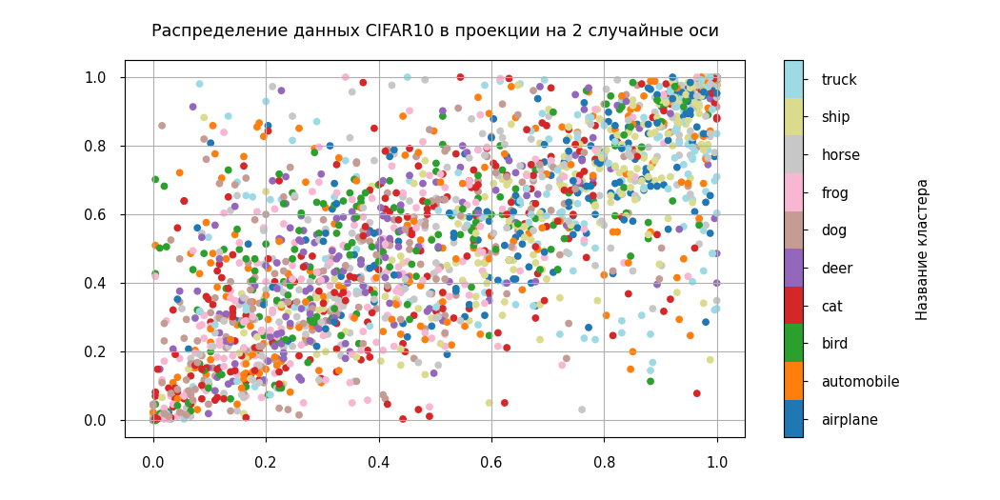

In [ ]:
# Если картинка окажется слишком маленькой/большой, то поменяйте image_scale на подходящее значение
plot_interactive(
    cifar10_data_train[:, [17, 64]], cifar10_images_train, cifar10_labels_train,
    cifar10_test_dataset.classes, n_dots=2000, image_scale=0.35
)

Вернёмся в статичный режим отрисовки изображений:

In [ ]:
%matplotlib inline
matplotlib.rcParams['figure.dpi'] = 300

#### **Задание 2.1 [кросспроверка, 1 балл][код]**
<a id='task_2.1'></a>
Воспользуйтесь алгоритмами снижения размерности `TSNE`, `UMAP`, `Isomap`, `KernelPCA` для визуализации картинок.

Полезные ссылки:
* [TSNE](https://distill.pub/2016/misread-tsne/)
* [UMAP](https://pair-code.github.io/understanding-umap/)
* [Isomap](https://www.sjsu.edu/faculty/guangliang.chen/Math253S20/lec10ISOmap.pdf)
* [Kernel](https://web.stanford.edu/~lmackey/stats306b/doc/stats306b-spring14-lecture8_slides.pdf) [PCA](https://web.stanford.edu/~lmackey/stats306b/doc/stats306b-spring14-lecture8_scribed.pdf)

Ссылки на документацию:
* [TSNE](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html)
* [UMAP](https://umap-learn.readthedocs.io/en/latest/)
* [Isomap](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.Isomap.html)
* [KernelPCA](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.KernelPCA.html)

Постройте визуализацию низкоразмерного представления, полученного с помощью этих моделей — изобразите четыре графика в одной строке. Во второй строке отобразите результат применения обученных моделей на тестовой выборке. Если для данного алгоритма невозможно сделать предсказания на тестовой выборке — оставьте соответствующий график пустым. Обозначьте разными цветами разные классы объектов. Для повышения производительности можете отобразить только часть выборки на графике ($1000\text{-}2000$ объектов).

*Замечание:* обратите внимание, что все алгоритмы снижения размерности также требуют правильного <font color="red">масштабирования признаков</font>, для корректной работы и интерпретируемых результатов.